# Template of  jupyter notebook for analysis of WAXS

# Load package

In [1]:
%matplotlib notebook
from pyScatt.packages import *
plt.rcParams.update({'figure.max_open_warning': 0})
plt.rcParams.update({ 'image.origin': 'lower'   })
plt.rcParams.update({ 'image.interpolation': 'none'   })

In [2]:
%run -i /home/yuzhang/Software/pyScatt/pyScatt/Scattering.py
%run -i /home/yuzhang/Software/pyScatt/pyScatt/generic_functions.py

## Define path

In [3]:
scat = 'WAXS'
det =  'Pilatus300kw' 


cycle = '2020_Cycle'
beamline = 'SMI'

username = 'AB2_1' 
inDir =  '/home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/AB2_1/'
#inDir ='/home/yuzhang/NSLSII_Data_Link/SMI/%s/%s/raw_data/%s/'%(cycle, proposal, det )
print('The input dir is: %s'%inDir)


outDir0_ =  '/home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/'
outDir0_ = create_fullpath(  outDir0_ )
outDir0 = create_fullpath(  outDir0_ + username + '/' )
print('The output dir is: %s'%outDir0)

The input dir is: /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/AB2_1/
Directory  /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/  already exists
Directory  /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/  already exists
The output dir is: /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/


In [4]:
flag_save = True 

outDir = create_fullpath(  outDir0   + '%s/'%(scat)) 
#outDir = create_dir(  'Results/', outDir1 )
outDir_stitched = create_fullpath(  outDir0   + 'Stitched/' ) 
#outDir2 = create_fullpath(  outDir0   + 'Stitched/pngs/' ) 
#create_dir( '%s/Results/TIFF/'%(scat), outDir0  )
outDir_HDF =  create_dir(  'HDF_Results/', outDir0 )
#outDir_ResPipe = create_dir(  'ResPipes/', outDir1 )

print( outDir )
print( outDir_HDF)
#print( outDir_ResPipe)
print( outDir_stitched )

Directory  /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/  already exists
Directory  /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/Stitched/  already exists
Directory  /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/HDF_Results/  already exists
/home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
/home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/HDF_Results/
/home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/Stitched/


# Find data

In [5]:
username_ = 'AB2'

flists = ls_dir( inDir, and_list=[  username_ ], no_list=[ ])
Nf = len( flists)
print('There are %s files for user: %s in this run.'%(Nf, username))

There are 448 files for user: AB2_1 in this run.


In [6]:
flists

array(['AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49350_waxs00.00_0.1s_000001_WAXS.tif',
       'AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49350_waxs06.50_0.1s_000001_WAXS.tif',
       'AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49350_waxs13.00_0.1s_000001_WAXS.tif',
       'AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49350_waxs19.50_0.1s_000001_WAXS.tif',
       'AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49550_waxs00.00_0.1s_000001_WAXS.tif',
       'AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49550_waxs06.50_0.1s_000001_WAXS.tif',
       'AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49550_waxs13.00_0.1s_000001_WAXS.tif',
       'AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49550_waxs19.50_0.1s_000001_WAXS.tif',
       'AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49750_waxs00.00_0.1s_000001_WAXS.tif',
       'AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49750_waxs06.50_0.1s_000001_WAXS.tif',
       'AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49750_waxs13.00_0.1s_000001_WAXS.tif',

## Sort data

In [7]:
sam_dict, sams = get_Unique_SamDict_from_list( flists, cut_pattern= r'[_][w][a]', starting_point=0,     )   
ks =  sorted(list(sams.keys()))
N = len(ks)
print( 'There are %s samples.'%(N))

There are 112 samples.


In [8]:
%run -i /home/yuzhang/Software/pyScatt/pyScatt/IO.py
%run -i /home/yuzhang/Software/pyScatt/pyScatt/generic_functions.py

In [9]:
i =  3
sam =  ks[i] 
print( sam )
flist  = sam_dict[ ks[i]]
#print( flist)
cut_beg = -26
cut_end=-21
sflistd = sort_fnlist( flist, pattern='', cut_beg = cut_beg, cut_end=cut_end, method='cut_from_end' )
sflist = np.array( list(sflistd.values()) )
sflist 
sflistd



AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49950


{'00.00': 'AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49950_waxs00.00_0.1s_000001_WAXS.tif',
 '06.50': 'AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49950_waxs06.50_0.1s_000001_WAXS.tif',
 '13.00': 'AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49950_waxs13.00_0.1s_000001_WAXS.tif',
 '19.50': 'AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49950_waxs19.50_0.1s_000001_WAXS.tif'}

## loop to sort data

In [10]:
ssam_dict = {}    
for sam in ks:     
    #print( 'The sample is: %s.'%sam)
    flist = np.sort( sam_dict[ sam ] )
    sflistd = sort_fnlist( flist, pattern='', cut_beg = cut_beg, cut_end=cut_end, method='cut_from_end' )
    sflist = np.array( list(sflistd.values()) )
    sd = sflistd  
    #ssam_dict[sam] =sd
    ssam_dict[sam] =list(sd.values())


# Load mask

In [11]:
#mask  =np.load( '/home/yuzhang/NSLSII_Data_Link/SMI/2020_Cycle3/308052_Zhang/Mask/mask_waxs_2020C3_YG.npy')
#show_img(mask)
mask = None

## Define parameters

In [12]:
%run -i /home/yuzhang/Software/pyScatt/pyScatt/Scattering.py

In [13]:
geometry   =  'Reflection'
wav_m = 1E-10 * (12.398/16.1)
sdd_mm = 274.0
b_xy = [96, 1475-85]
bs_xy = [96, 1203]
incident_angle = 0
det_str =  'Pilatus300kw'
hotpixel_thres = 1e6
  
pargs_sc = dict( wav_m = wav_m, 
                sdd_mm = sdd_mm, 
                b_xy =b_xy, 
                bs_xy = bs_xy, 
                incident_angle = incident_angle,             
                det_str = det_str, 
                bs_kind = None, 
                useqx = True,
                geometry =  geometry,                
                username = username, # 'Fang', 
                cycle =  cycle, # ='2020_Cycle2',
                beamline = beamline, #'SMI',
                outDir = outDir, )
              # mask = mask )
    
N =  4
rot_angle_start = 0
rot_angle_step = 6.5 
rot_angle = -np.arange( rot_angle_start,  rot_angle_step * N,  rot_angle_step )
print(rot_angle)

## Setup the class
SC = SMI_Scattering( pargs_sc  )
SC.set_rotation_angles( rot_angle  ) 


[ -0.   -6.5 -13.  -19.5]


In [14]:
%matplotlib inline


In [15]:
#%matplotlib notebook

# Do data reduction

In [16]:
T = True
F = False

In [17]:
%run -i /home/yuzhang/Software/pyScatt/pyScatt/generic_functions.py
%run -i /home/yuzhang/Software/pyScatt/pyScatt/Scattering.py
%run -i /home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py

In [18]:
do_plot = T #True 
do_plot_raw = T # True
#do_inpait = True, make it True, the circular average does not use inpaited data 

do_show_plot = T
save_raw = F


if T:    
    ###########################
    #for stitch
    ###########################
    do_qimg = F
    check_stitch = F
    do_stitch = T
    do_ciravg = T
    do_ciravg_sector = T   
    show_ciravg_sector = F
    
    ciravg_sector_angle_wid = 10 
    ciravg_sector_angles = [  10,  30,  50, 70, 90    ]    
    
   
    

In [19]:
sample_list = ks[ 3:4 ]
sample_list = ks   #use a dummy papemill to run this
print( sample_list )

['AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49350', 'AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49550', 'AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49750', 'AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49950', 'AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x48550', 'AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x48750', 'AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x48950', 'AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x49150', 'AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x47750', 'AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x47950', 'AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x48150', 'AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x48350', 'AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x46950', 'AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x47150', 'AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x47350', 'AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x47550', 'AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36150', 'AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36350', 'AB2_1_2_MeDPP_glass_thermal_

In [20]:
ssam_dict[sam]

['AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-34050_waxs00.00_0.1s_000001_WAXS.tif',
 'AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-34050_waxs06.50_0.1s_000001_WAXS.tif',
 'AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-34050_waxs13.00_0.1s_000001_WAXS.tif',
 'AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-34050_waxs19.50_0.1s_000001_WAXS.tif']

The sample is: AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49350.
['AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49350_waxs00.00_0.1s_000001_WAXS.tif', 'AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49350_waxs06.50_0.1s_000001_WAXS.tif', 'AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49350_waxs13.00_0.1s_000001_WAXS.tif', 'AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49350_waxs19.50_0.1s_000001_WAXS.tif']
[ -0.   -6.5 -13.  -19.5]


/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49350.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49350_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49350_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49350_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49350_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49350_qiq_angle=80_100.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/A

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49550.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49550_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49550_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49550_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49550_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49550_qiq_angle=80_100.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/A

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49750.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49750_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49750_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49750_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49750_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49750_qiq_angle=80_100.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/A

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49950.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49950_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49950_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49950_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49950_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.0800deg_x49950_qiq_angle=80_100.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/A

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x48550.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x48550_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x48550_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x48550_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x48550_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x48550_qiq_angle=80_100.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/A

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x48750.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x48750_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x48750_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x48750_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x48750_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x48750_qiq_angle=80_100.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/A

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x48950.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x48950_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x48950_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x48950_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x48950_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x48950_qiq_angle=80_100.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/A

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x49150.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x49150_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x49150_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x49150_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x49150_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1000deg_x49150_qiq_angle=80_100.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/A

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x47750.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x47750_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x47750_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x47750_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x47750_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x47750_qiq_angle=80_100.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/A

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x47950.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x47950_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x47950_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x47950_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x47950_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x47950_qiq_angle=80_100.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/A

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x48150.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x48150_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x48150_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x48150_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x48150_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x48150_qiq_angle=80_100.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/A

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x48350.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x48350_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x48350_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x48350_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x48350_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.1500deg_x48350_qiq_angle=80_100.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/A

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x46950.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x46950_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x46950_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x46950_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x46950_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x46950_qiq_angle=80_100.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/A

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x47150.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x47150_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x47150_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x47150_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x47150_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x47150_qiq_angle=80_100.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/A

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x47350.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x47350_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x47350_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x47350_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x47350_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x47350_qiq_angle=80_100.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/A

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x47550.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x47550_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x47550_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x47550_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x47550_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_1_MeDPP_glass_thermal_none_0.2000deg_x47550_qiq_angle=80_100.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/A

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36150.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36150_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36150_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36150_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36150_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36150_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36350.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36350_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36350_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36350_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36350_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36350_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36550.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36550_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36550_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36550_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36550_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36550_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36750.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36750_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36750_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36750_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36750_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.0800deg_x36750_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35350.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35350_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35350_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35350_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35350_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35350_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35550.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35550_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35550_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35550_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35550_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35550_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35750.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35750_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35750_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35750_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35750_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35750_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35950.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35950_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35950_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35950_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35950_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1000deg_x35950_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x34550.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x34550_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x34550_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x34550_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x34550_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x34550_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x34750.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x34750_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x34750_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x34750_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x34750_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x34750_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x34950.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x34950_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x34950_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x34950_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x34950_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x34950_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x35150.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x35150_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x35150_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x35150_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x35150_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.1500deg_x35150_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x33750.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x33750_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x33750_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x33750_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x33750_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x33750_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x33950.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x33950_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x33950_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x33950_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x33950_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x33950_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x34150.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x34150_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x34150_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x34150_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x34150_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x34150_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x34350.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x34350_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x34350_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x34350_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x34350_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_2_MeDPP_glass_thermal_0.5minVSADCM_0.2000deg_x34350_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22150.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22150_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22150_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22150_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22150_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22150_qiq_angle=80_100.csv is saved in /home

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22350.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22350_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22350_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22350_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22350_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22350_qiq_angle=80_100.csv is saved in /home

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22550.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22550_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22550_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22550_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22550_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22550_qiq_angle=80_100.csv is saved in /home

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22750.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22750_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22750_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22750_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22750_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.0800deg_x22750_qiq_angle=80_100.csv is saved in /home

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21350.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21350_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21350_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21350_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21350_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21350_qiq_angle=80_100.csv is saved in /home

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21550.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21550_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21550_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21550_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21550_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21550_qiq_angle=80_100.csv is saved in /home

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21750.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21750_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21750_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21750_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21750_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21750_qiq_angle=80_100.csv is saved in /home

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21950.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21950_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21950_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21950_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21950_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1000deg_x21950_qiq_angle=80_100.csv is saved in /home

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x20550.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x20550_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x20550_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x20550_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x20550_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x20550_qiq_angle=80_100.csv is saved in /home

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x20750.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x20750_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x20750_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x20750_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x20750_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x20750_qiq_angle=80_100.csv is saved in /home

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x20950.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x20950_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x20950_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x20950_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x20950_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x20950_qiq_angle=80_100.csv is saved in /home

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x21150.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x21150_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x21150_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x21150_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x21150_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.1500deg_x21150_qiq_angle=80_100.csv is saved in /home

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x19750.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x19750_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x19750_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x19750_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x19750_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x19750_qiq_angle=80_100.csv is saved in /home

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x19950.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x19950_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x19950_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x19950_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x19950_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x19950_qiq_angle=80_100.csv is saved in /home

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x20150.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x20150_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x20150_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x20150_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x20150_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x20150_qiq_angle=80_100.csv is saved in /home

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x20350.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x20350_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x20350_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x20350_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x20350_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_3_MeDPP_glass_thermal_1minVSADCM_0.2000deg_x20350_qiq_angle=80_100.csv is saved in /home

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9150.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9150_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9150_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9150_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9150_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9150_qiq_angle=80_100.csv is saved in /home/group

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9350.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9350_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9350_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9350_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9350_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9350_qiq_angle=80_100.csv is saved in /home/group

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9550.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9550_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9550_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9550_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9550_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9550_qiq_angle=80_100.csv is saved in /home/group

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9750.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9750_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9750_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9750_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9750_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.0800deg_x9750_qiq_angle=80_100.csv is saved in /home/group

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8350.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8350_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8350_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8350_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8350_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8350_qiq_angle=80_100.csv is saved in /home/group

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8550.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8550_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8550_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8550_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8550_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8550_qiq_angle=80_100.csv is saved in /home/group

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8750.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8750_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8750_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8750_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8750_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8750_qiq_angle=80_100.csv is saved in /home/group

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8950.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8950_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8950_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8950_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8950_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1000deg_x8950_qiq_angle=80_100.csv is saved in /home/group

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x7550.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x7550_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x7550_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x7550_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x7550_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x7550_qiq_angle=80_100.csv is saved in /home/group

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x7750.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x7750_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x7750_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x7750_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x7750_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x7750_qiq_angle=80_100.csv is saved in /home/group

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x7950.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x7950_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x7950_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x7950_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x7950_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x7950_qiq_angle=80_100.csv is saved in /home/group

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x8150.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x8150_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x8150_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x8150_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x8150_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.1500deg_x8150_qiq_angle=80_100.csv is saved in /home/group

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x6750.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x6750_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x6750_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x6750_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x6750_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x6750_qiq_angle=80_100.csv is saved in /home/group

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x6950.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x6950_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x6950_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x6950_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x6950_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x6950_qiq_angle=80_100.csv is saved in /home/group

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x7150.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x7150_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x7150_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x7150_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x7150_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x7150_qiq_angle=80_100.csv is saved in /home/group

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x7350.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x7350_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x7350_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x7350_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x7350_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_4_MeDPP_glass_thermal_5minVSADCM_0.2000deg_x7350_qiq_angle=80_100.csv is saved in /home/group

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-2550.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-2550_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-2550_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-2550_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-2550_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-2550_qiq_angle=80_100.csv is saved in

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-2750.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-2750_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-2750_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-2750_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-2750_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-2750_qiq_angle=80_100.csv is saved in

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-2950.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-2950_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-2950_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-2950_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-2950_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-2950_qiq_angle=80_100.csv is saved in

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-3150.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-3150_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-3150_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-3150_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-3150_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.0800deg_x-3150_qiq_angle=80_100.csv is saved in

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3350.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3350_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3350_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3350_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3350_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3350_qiq_angle=80_100.csv is saved in

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3550.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3550_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3550_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3550_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3550_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3550_qiq_angle=80_100.csv is saved in

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3750.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3750_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3750_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3750_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3750_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3750_qiq_angle=80_100.csv is saved in

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3950.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3950_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3950_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3950_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3950_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1000deg_x-3950_qiq_angle=80_100.csv is saved in

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4150.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4150_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4150_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4150_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4150_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4150_qiq_angle=80_100.csv is saved in

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4350.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4350_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4350_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4350_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4350_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4350_qiq_angle=80_100.csv is saved in

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4550.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4550_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4550_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4550_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4550_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4550_qiq_angle=80_100.csv is saved in

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4750.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4750_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4750_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4750_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4750_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.1500deg_x-4750_qiq_angle=80_100.csv is saved in

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-4950.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-4950_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-4950_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-4950_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-4950_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-4950_qiq_angle=80_100.csv is saved in

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-5150.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-5150_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-5150_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-5150_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-5150_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-5150_qiq_angle=80_100.csv is saved in

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-5350.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-5350_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-5350_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-5350_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-5350_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-5350_qiq_angle=80_100.csv is saved in

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-5550.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-5550_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-5550_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-5550_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-5550_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_5_MeDPP_glass_thermal_15minVSADCM_0.2000deg_x-5550_qiq_angle=80_100.csv is saved in

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-16550.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-16550_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-16550_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-16550_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-16550_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-16550_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-16750.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-16750_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-16750_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-16750_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-16750_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-16750_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-16950.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-16950_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-16950_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-16950_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-16950_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-16950_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-17150.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-17150_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-17150_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-17150_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-17150_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.0800deg_x-17150_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17350.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17350_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17350_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17350_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17350_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17350_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17550.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17550_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17550_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17550_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17550_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17550_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17750.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17750_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17750_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17750_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17750_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17750_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17950.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17950_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17950_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17950_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17950_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1000deg_x-17950_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18150.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18150_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18150_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18150_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18150_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18150_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18350.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18350_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18350_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18350_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18350_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18350_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18550.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18550_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18550_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18550_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18550_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18550_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18750.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18750_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18750_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18750_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18750_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.1500deg_x-18750_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-18950.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-18950_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-18950_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-18950_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-18950_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-18950_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-19150.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-19150_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-19150_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-19150_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-19150_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-19150_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-19350.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-19350_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-19350_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-19350_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-19350_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-19350_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-19550.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-19550_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-19550_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-19550_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-19550_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_6_MeDPP_glass_thermal_60minVSADCM_0.2000deg_x-19550_qiq_angle=80_100.csv is sa

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31050.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31050_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31050_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31050_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31050_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31050_qiq_angle=80_100.csv

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31250.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31250_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31250_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31250_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31250_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31250_qiq_angle=80_100.csv

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31450.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31450_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31450_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31450_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31450_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31450_qiq_angle=80_100.csv

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31650.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31650_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31650_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31650_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31650_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.0800deg_x-31650_qiq_angle=80_100.csv

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-31850.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-31850_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-31850_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-31850_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-31850_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-31850_qiq_angle=80_100.csv

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-32050.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-32050_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-32050_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-32050_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-32050_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-32050_qiq_angle=80_100.csv

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-32250.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-32250_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-32250_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-32250_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-32250_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-32250_qiq_angle=80_100.csv

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-32450.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-32450_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-32450_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-32450_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-32450_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1000deg_x-32450_qiq_angle=80_100.csv

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-32650.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-32650_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-32650_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-32650_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-32650_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-32650_qiq_angle=80_100.csv

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-32850.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-32850_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-32850_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-32850_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-32850_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-32850_qiq_angle=80_100.csv

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-33050.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-33050_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-33050_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-33050_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-33050_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-33050_qiq_angle=80_100.csv

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-33250.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-33250_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-33250_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-33250_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-33250_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.1500deg_x-33250_qiq_angle=80_100.csv

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-33450.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-33450_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-33450_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-33450_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-33450_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-33450_qiq_angle=80_100.csv

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-33650.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-33650_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-33650_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-33650_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-33650_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-33650_qiq_angle=80_100.csv

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-33850.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-33850_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-33850_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-33850_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-33850_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-33850_qiq_angle=80_100.csv

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )
/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


The file: waxs_q_iq_Oy=8pix_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-34050.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-34050_qiq_angle=0_20.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-34050_qiq_angle=20_40.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-34050_qiq_angle=40_60.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-34050_qiq_angle=60_80.csv is saved in /home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/Results/AB2_1/WAXS/
The file: waxs_qs_iqs_AB2_1_7_MeDPP_glass_thermal_240minVSADCM_0.2000deg_x-34050_qiq_angle=80_100.csv

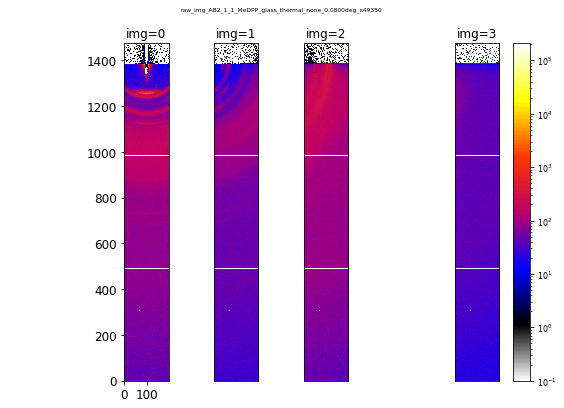

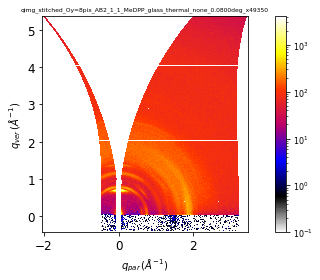

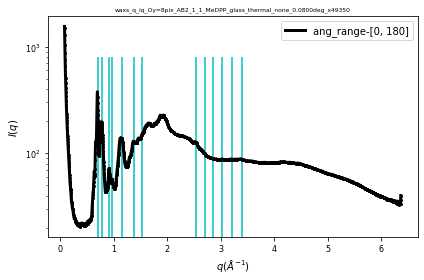

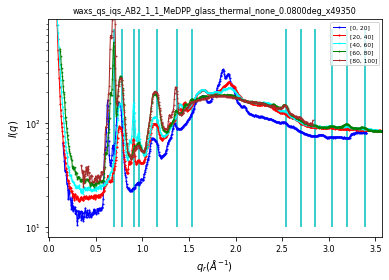

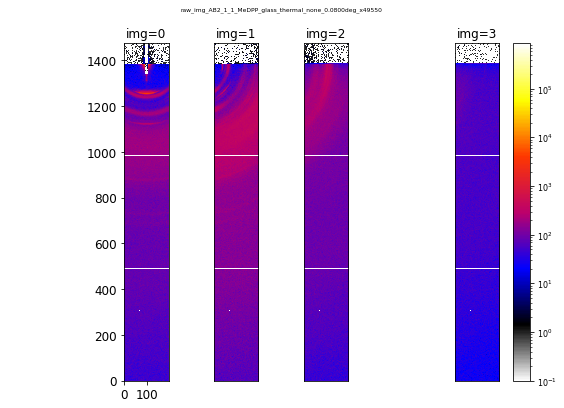

...

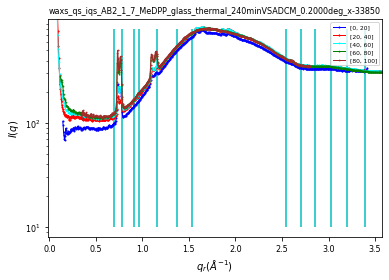

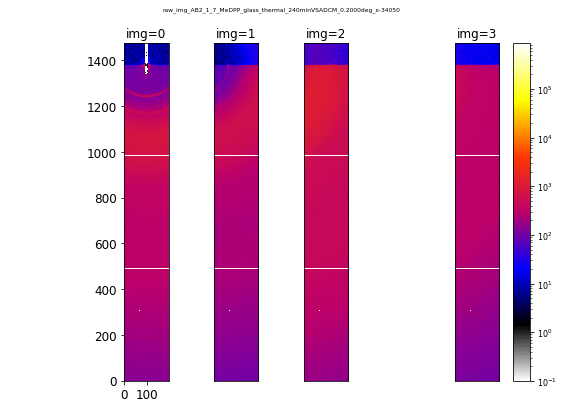

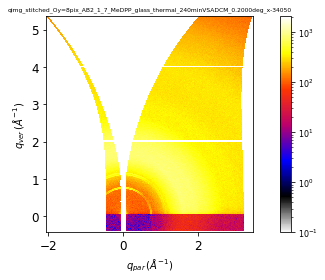

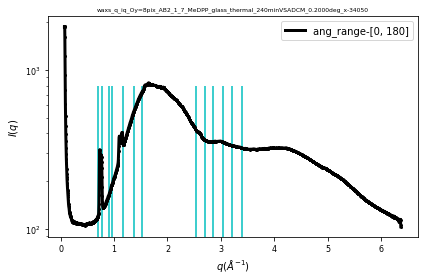

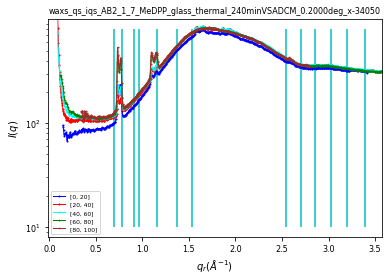

In [21]:
#loop all samples
for sam in sample_list: 
    print( 'The sample is: %s.'%sam)    
    fps = ssam_dict[sam] [:4]
    print( fps )
    RES = {}  
    saved_plots = {}  
    saved_data = {}     
    full_filenames = [ inDir +  fp for fp in fps   ] 
    N =  len(full_filenames)
    rot_angle = -np.arange( rot_angle_start,  rot_angle_step * N,  rot_angle_step )
    print(rot_angle)
    p0 = re.search( r'([d][e][g])', sam  ).span()[0]
    inc = float( sam[ p0-6:p0] )
    pargs_sc['rotation_angles'] = rot_angle
    pargs_sc['incident_angle'] = inc
    SC = SMI_Scattering( pargs_sc  ) 
    SC.md['sample'] = sam
    SC.load_data( full_filenames )  
    #SC.md['sid'] =  []
    #######################################
    #plot the raw data
    ########################################
    if do_plot_raw:
        title='raw_img_%s'%(sam)
        #fig, ax= plt.subplots()
        SC.plot_imgs( imgs=SC.imgs, title=title, vmin= None, vmax=None,  
                     save=True,mask= mask, fontsize=6, outDir=SC.outDir  )
        if not do_show_plot:
            plt.close(fig)                
        saved_plots['raw'] = SC.outDir + title + '.png' 
            
    offset_y   = 8 #8 #-16 #32 #16 # 16       
    if check_stitch:        
        q_ch, iq_ch, int_dict_ch, qx_dict_ch, qz_dict_ch = SC.check_stitich( offset_y = offset_y )  
        if do_plot:
            title =  'check_stitched_q_iq_Oy=%spix_%s'%(offset_y, sam )  
            fig, ax = plt.subplots()
            SC.plot_check_stitich( title=title,fig_ax=[fig,ax],fontsize=8  ) 
            peaks = np.array( [ 0.697,  0.77985, 0.91, 0.967, 1.16, 1.367, 1.53, 2.54, 2.7, 2.85, 3.03, 3.2, 3.39 ] )            
            ax.vlines( peaks, 10, 800, color='c',)
            #ax.set_ylim( 300, 2e4)  
            ax.set_xlim( .4, 4 )  
            plt.tight_layout()
            plt.savefig(  SC.outDir   + title + '_.png')  
            saved_plots['check_stitch'] = SC.outDir + title + '.png' 
            
            
    if do_stitch:
        saved_data['stitched'] = []
        dq_mag = 5        
        qimg_st, msk_st, qx_st, qz_st, sca_st = SC.stitich( dq_mag = dq_mag, offset_y= offset_y, flag_scale= T ) 
        title=outDir_stitched + 'Stitched_Oy=%spix_%s.tiff'%(offset_y,sam )        
        save_array_to_tiff( qimg_st, title )
        saved_data['stitched'] .append(  title )
        title='Stitched_qx_Oy=%spix_%s.csv'%(offset_y,sam )
        save_lists( [qx_st], label=['qx_st' ], filename=title, path = outDir_stitched )
        saved_data['stitched'] .append(  title )
        title='Stitched_qz_Oy=%spix_%s.csv'%(offset_y,sam )
        save_lists( [ qz_st], label=['qz_st' ], filename= title, path = outDir_stitched )        
        if do_plot:
            title= 'qimg_stitched_Oy=%spix_%s'%(offset_y, sam )
            SC.plot_stitched_waxs( title=title, vmin= None, vmax=None,fontsize=6,
                                  save=True, outDir=SC.outDir  )  
            saved_plots['qiq'] = SC.outDir + title + '.png'  
    
    if do_ciravg:           
        Prange = [0,180] # None
        Qrange =  None
        qx_roi_range = [ qx_st.min(), qx_st.max()]
        #qz_roi_range= [qz_st.min(), qz_st.max() ]         #  [qz_st.min(), 1.1 ] 
        qz_roi_range= [ 0.05,  qz_st.max() ]         #  [qz_st.min(), 1.1 ]   
        ciravg_bins  = 2500 
        qmaskn = create_roiMask_from_Qimg( qimg=qimg_st, qx_range=qx_st, 
                                  qz_range=qz_st, qx_roi_range=qx_roi_range,qz_roi_range=qz_roi_range,qmask =msk_st )         
        q_ca,iq_ca,mask_ca = SC.qimg_circular_average( qimg_st, qx_st, qz_st, 
                                                      bins=ciravg_bins, Prange= Prange, Qrange= Qrange,
                                                      mask=qmaskn ) 
        SC.qx_roi_range_ca = qx_roi_range
        SC.qz_roi_range_ca = qz_roi_range        
        title= 'waxs_q_iq_Oy=%spix_%s'%(offset_y, sam  )
        save_arrays(  data= [q_ca, iq_ca], label= ['q_ca','iq_ca'], dtype='list', 
                    filename=title+'.csv', path= SC.outDir, return_res = False,verbose=True) 
        saved_data['qiq'] = SC.outDir + title+'.csv'  
        if do_plot:   
            if F:
                title= 'qimg_stitched_mask_ca_Oy=%spix_%s'%(offset_y, sam )
                SC.plot_stitched_waxs(  img=SC.qimg_st * qmaskn, #vmin= 5.00, vmax=1e5,
                                       vmin= None, vmax=None,fontsize=6,
                                      title= title, save=True, outDir=SC.outDir  ) 
                saved_plots['qiq_roi_mask'] = title + '.png'
                title= 'waxs_q_iq_Oy=%spix_%s'%(offset_y, sam )
            fig, ax = plt.subplots()
            #Prange=[0,180]
            SC.plot_q_iq( q_ca,iq_ca, legend = 'ang_range-%s'%Prange,fig_ax=[fig,ax],fontsize=6,
                         title = title)  
            peaks = np.array( [ 0.697,  0.77985, 0.91, 0.967, 1.16, 1.367, 1.53, 2.54, 2.7, 2.85, 3.03, 3.2, 3.39 ] )            
            ax.vlines( peaks, 10, 800, color='c',)
            #ax.set_ylim( 300, 2e4)  
            plt.tight_layout()
            plt.savefig(  SC.outDir   + title + '_.png') 
            saved_plots['qiq'] = SC.outDir + title + '.png'
            

        if do_ciravg_sector: 
            saved_data['qiq_sec'] = []
            Prange =   [ [w-ciravg_sector_angle_wid, w+ciravg_sector_angle_wid] for w in  ciravg_sector_angles  ]
            Qrange =  None               
            title =  'waxs_qs_iqs_%s'%(sam)
            qiqs_cas,   qmask_cas = SC.qimg_circular_average_sector(qimg_st , qx_st, qz_st,
                                        Qrange=Qrange,Prange=Prange,bins=1500,mask= qmaskn )                 
            for i, kx in enumerate(list( qiqs_cas.keys() )):    
                a1,a2=Prange[i]
                title_sub = title+'_qiq_angle=%s_%s.csv'%(a1,a2)
                save_arrays(  data=qiqs_cas[kx], label= ['q','Iq-angle=%s_%s'%(a1,a2)], dtype='array', 
                        filename=title_sub,
                            path= SC.outDir, return_res = False,verbose=True) 
                saved_data['qiq_sec'].append(  SC.outDir + title_sub   )  

            if do_plot:    
                fig, ax= plt.subplots()
                ax.vlines( peaks, 10, 800, color='c',)
                SC.plot_stacked_multi_curves( xys = qiqs_cas, yshift = 1e2, save=True,
                                             legends= Prange, fig_ax=[fig,ax],
                                      xlabel= r'$q_r(\AA^{-1})$', title =  title, fontsize=8 ) 
                if not do_show_plot:
                    plt.close(fig) 
                saved_plots['qiq_sec'] = SC.outDir + title + '.png'
            if show_ciravg_sector:
                N = len(Prange)
                fig,axes=create_fig_ax( H=1,V=N, figsize=[8,4],  y=1.08, title='ciravg_sector_cuts' )
                for i, ki in enumerate(list(qmask_cas.keys())):
                    show_img( qmask_cas[ ki ], ax=[fig, axes[i]], image_name = Prange[i])
                        
   ## save data to h5 file 
    res = SC.res_to_dict( do_stitch=do_stitch, do_ciravg =do_ciravg, save_raw=save_raw,
                         do_ciravg_sector = do_ciravg_sector )                        
                      
        #do_qphi = do_qphi, 
                          #do_q_qphi = do_q_qphi, do_p_qphi = do_p_qphi, )
    res['md'] = {} 
    res['md'].update( SC.md   )     
    res['md']['offestY'] =  offset_y
    
    dicttoh5( res, os.path.join(outDir_HDF, '%s.h5'%sam),
                     h5path='/WAXS/', mode='a', overwrite_data=True)           
 
print('Done')               
    

# The END!